<a href="https://colab.research.google.com/github/jigyasumxkkxr/Finger-Identification/blob/main/Fingers.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [6]:
#!unzip "drive/MyDrive/Fingers/train.zip" -d "drive/MyDrive/Fingers"

Streaming output truncated to the last 5000 lines.
  inflating: drive/MyDrive/Fingers/train/b90d0c32-1ed4-4d99-b116-439ae9e5ebba_1R.png  
 extracting: drive/MyDrive/Fingers/train/b912446e-1f0e-484b-a06a-81d775b4caf3_3L.png  
 extracting: drive/MyDrive/Fingers/train/b914ab2b-a181-487a-96bc-5e9186566a13_3R.png  
  inflating: drive/MyDrive/Fingers/train/b91591d8-cbf4-45e0-81ad-debdc3a7a781_1L.png  
  inflating: drive/MyDrive/Fingers/train/b917b1f5-8372-49b0-8601-d8244d736abb_1R.png  
 extracting: drive/MyDrive/Fingers/train/b920b98a-f844-4659-8d73-4610549fc3a2_3L.png  
 extracting: drive/MyDrive/Fingers/train/b920bff3-4ad0-4685-961d-5843a27af49a_5L.png  
  inflating: drive/MyDrive/Fingers/train/b92136e3-7b17-41e1-a20e-723cc4516df3_0R.png  
  inflating: drive/MyDrive/Fingers/train/b921a0bf-688b-424b-aea2-e42a72f84fd6_2L.png  
  inflating: drive/MyDrive/Fingers/train/b92367f8-c20a-4ca2-bf08-6e312e646f1f_0R.png  
  inflating: drive/MyDrive/Fingers/train/b924cf6c-2707-4384-a3db-3756abf739ed_0

In [7]:
import os

folder_path = 'drive/MyDrive/Fingers/train'  # Replace this with the path to your folder

# List all files in the folder
files = os.listdir(folder_path)

# Count the number of files
num_files = len(files)

print("Number of files in the folder:", num_files)


Number of files in the folder: 18000


In [4]:
import os

folder_path = 'drive/MyDrive/Fingers/test'  # Replace this with the path to your folder

# List all files in the folder
files = os.listdir(folder_path)

# Count the number of files
num_files = len(files)

print("Number of files in the folder:", num_files)


Number of files in the folder: 3600


In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [8]:
import tensorflow as tf
import tensorflow_hub as hub

In [9]:
print("GPU","Available"if tf.config.list_physical_devices("GPU") else "not available :(")

GPU Available


In [10]:
import os
import csv
folder_path_train="drive/MyDrive/Fingers/train"
folder_path_test="drive/MyDrive/Fingers/test"
files_train=os.listdir(folder_path_train)
files_test=os.listdir(folder_path_test)
image_files_train = [file for file in files_train if file.endswith('png')]
image_files_test = [file for file in files_test if file.endswith('png')]
csv_file_path_train = 'drive/My Drive/Fingers/image_names_train.csv'
csv_file_path_test ='drive/My Drive/Fingers/image_names_test.csv'
with open(csv_file_path_train, 'w', newline='') as csvfile:
    fieldnames = ['Image Name']
    writer = csv.DictWriter(csvfile, fieldnames=fieldnames)

    writer.writeheader()
    for image_name in image_files_train:
        writer.writerow({'Image Name': image_name})
with open(csv_file_path_test, 'w', newline='') as csvfile:
    fieldnames = ['Image Name']
    writer = csv.DictWriter(csvfile, fieldnames=fieldnames)

    writer.writeheader()
    for image_name in image_files_test:
        writer.writerow({'Image Name': image_name})

In [12]:
import pandas as pd
labels_train=pd.read_csv("drive/MyDrive/Fingers/image_names_train.csv")
labels_test=pd.read_csv("drive/MyDrive/Fingers/image_names_test.csv")

In [13]:
print(labels_train.describe())
print(labels_train.head())

                                         Image Name
count                                         18000
unique                                        18000
top     fffaffc3-3fe7-44b6-94a1-3e31852dab77_2L.png
freq                                              1
                                    Image Name
0  00048bba-979b-4f84-b833-5bbbb082b582_0L.png
1  000547a2-d456-4b16-b351-12ca9b40e390_0L.png
2  000cac8e-fcf0-4f8c-bd16-c257d1e6d7a8_2L.png
3  000d9961-8136-4dee-9820-86e178777958_0L.png
4  0010095b-2e3d-4517-a511-1f688c378f96_5L.png


In [14]:
print(labels_test.describe())
print(labels_test.head())

                                         Image Name
count                                          3600
unique                                         3600
top     2c51e168-6eb4-4f8b-9d64-31bc3814a34a_3R.png
freq                                              1
                                    Image Name
0  b7d1abc7-6882-4074-b15d-e1132cc69153_2L.png
1  ba8b2134-a68b-4210-aaaf-94ee0159c662_3L.png
2  bbcea6a4-3250-400f-a6d9-e5500d8f0366_5L.png
3  b98c60c1-7519-4d5c-909f-9779b14261e0_5L.png
4  bad120e0-aa2f-4bc4-83eb-1129be22fe83_5R.png


In [17]:
filenames=["drive/MyDrive/Fingers/train/"+fnames for fnames in labels_train["Image Name"]]
filenames[:10]

['drive/MyDrive/Fingers/train/00048bba-979b-4f84-b833-5bbbb082b582_0L.png',
 'drive/MyDrive/Fingers/train/000547a2-d456-4b16-b351-12ca9b40e390_0L.png',
 'drive/MyDrive/Fingers/train/000cac8e-fcf0-4f8c-bd16-c257d1e6d7a8_2L.png',
 'drive/MyDrive/Fingers/train/000d9961-8136-4dee-9820-86e178777958_0L.png',
 'drive/MyDrive/Fingers/train/0010095b-2e3d-4517-a511-1f688c378f96_5L.png',
 'drive/MyDrive/Fingers/train/00147c9a-67f5-4e86-a56b-681f0815ef2b_5R.png',
 'drive/MyDrive/Fingers/train/0014eacf-b0b7-49af-9d67-83661b3debb4_2R.png',
 'drive/MyDrive/Fingers/train/001cddc6-e29c-44da-82d5-bd00ec215f07_2R.png',
 'drive/MyDrive/Fingers/train/001e18d6-4632-4876-a922-7b4ead742070_3L.png',
 'drive/MyDrive/Fingers/train/00218888-86f2-4154-87f1-003dee60af03_0R.png']

In [18]:
num_chars_to_keep = 6
labels_train['Image Name'] = labels_train['Image Name'].str[-num_chars_to_keep:]
labels_train['Image Name'] = labels_train['Image Name'].str[:-4]
labels_train.to_csv("drive/MyDrive/Fingers/image_names_train.csv", index=False)

In [19]:
print(labels_train.describe())
print(labels_train.head())

       Image Name
count       18000
unique         12
top            0L
freq         1500
  Image Name
0         0L
1         0L
2         2L
3         0L
4         5L


In [23]:
num_chars_to_keep = 6
labels_test['Image Name'] = labels_test['Image Name'].str[-num_chars_to_keep:]
labels_test['Image Name'] = labels_test['Image Name'].str[:-4]
labels_test.to_csv("drive/MyDrive/Fingers/image_names_test.csv", index=False)

In [24]:
print(labels_test.describe())
print(labels_test.head())

       Image Name
count        3600
unique          1
top              
freq         3600
  Image Name
0           
1           
2           
3           
4           


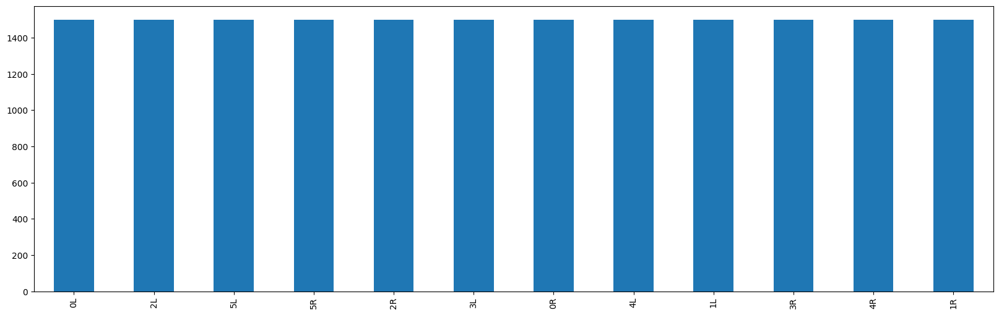

In [20]:
labels_train["Image Name"].value_counts().plot.bar(figsize=(20,6));

In [ ]:
labels_test["Image Name"].value_counts().plot.bar(figsize=(20,6));

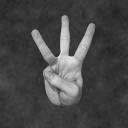

In [25]:
from IPython.display import Image
Image("drive/MyDrive/Fingers/train/0a1a077a-5197-44d9-8607-248bf244930d_3R.png")

In [26]:
import numpy as np
labels_T= labels_train["Image Name"].to_numpy()
labels_T[:10]

array(['0L', '0L', '2L', '0L', '5L', '5R', '2R', '2R', '3L', '0R'],
      dtype=object)

In [ ]:
labels_t= labels_test["Image Name"].to_numpy()
labels_t[:10]

array(['1L', '5L', '2R', '3L', '3R', '2R', '1R', '2R', '4R', '4R'],
      dtype=object)

In [27]:
unique_finger_train = np.unique(labels_T)
# unique_finger_test = np.unique(labels_T)

In [ ]:
# len(unique_finger_test)

12

In [28]:
len(unique_finger_train)

12

In [29]:
print(labels_T[0])
labels_T[0] == unique_finger_train # use comparison operator to create boolean array

0L


array([ True, False, False, False, False, False, False, False, False,
       False, False, False])

In [30]:
boolean_labels_train = [label == np.array(unique_finger_train) for label in labels_T]
boolean_labels_train[:2]

[array([ True, False, False, False, False, False, False, False, False,
        False, False, False]),
 array([ True, False, False, False, False, False, False, False, False,
        False, False, False])]

In [31]:
len(boolean_labels_train)

18000

In [32]:
print(labels_T[0]) # original label
print(np.where(unique_finger_train == labels_T[0])[0][0])
print(boolean_labels_train[0].argmax())
print(boolean_labels_train[0].astype(int))

0L
0
0
[1 0 0 0 0 0 0 0 0 0 0 0]


In [33]:
X=filenames
y=boolean_labels_train

In [34]:
X[:10]

['drive/MyDrive/Fingers/train/00048bba-979b-4f84-b833-5bbbb082b582_0L.png',
 'drive/MyDrive/Fingers/train/000547a2-d456-4b16-b351-12ca9b40e390_0L.png',
 'drive/MyDrive/Fingers/train/000cac8e-fcf0-4f8c-bd16-c257d1e6d7a8_2L.png',
 'drive/MyDrive/Fingers/train/000d9961-8136-4dee-9820-86e178777958_0L.png',
 'drive/MyDrive/Fingers/train/0010095b-2e3d-4517-a511-1f688c378f96_5L.png',
 'drive/MyDrive/Fingers/train/00147c9a-67f5-4e86-a56b-681f0815ef2b_5R.png',
 'drive/MyDrive/Fingers/train/0014eacf-b0b7-49af-9d67-83661b3debb4_2R.png',
 'drive/MyDrive/Fingers/train/001cddc6-e29c-44da-82d5-bd00ec215f07_2R.png',
 'drive/MyDrive/Fingers/train/001e18d6-4632-4876-a922-7b4ead742070_3L.png',
 'drive/MyDrive/Fingers/train/00218888-86f2-4154-87f1-003dee60af03_0R.png']

In [35]:
y[:10]

[array([ True, False, False, False, False, False, False, False, False,
        False, False, False]),
 array([ True, False, False, False, False, False, False, False, False,
        False, False, False]),
 array([False, False, False, False,  True, False, False, False, False,
        False, False, False]),
 array([ True, False, False, False, False, False, False, False, False,
        False, False, False]),
 array([False, False, False, False, False, False, False, False, False,
        False,  True, False]),
 array([False, False, False, False, False, False, False, False, False,
        False, False,  True]),
 array([False, False, False, False, False,  True, False, False, False,
        False, False, False]),
 array([False, False, False, False, False,  True, False, False, False,
        False, False, False]),
 array([False, False, False, False, False, False,  True, False, False,
        False, False, False]),
 array([False,  True, False, False, False, False, False, False, False,
        Fal

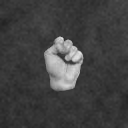

In [36]:
from IPython.display import Image
Image("drive/MyDrive/Fingers/train/00048bba-979b-4f84-b833-5bbbb082b582_0L.png")

In [38]:
NUM_IMAGES=1000 #@param {type:"slider",min:1000,max:10000,step:1000}
NUM_IMAGES

1000

In [39]:
from sklearn.model_selection import train_test_split
X_train, X_val, y_train, y_val = train_test_split(X[:NUM_IMAGES],
                                                  y[:NUM_IMAGES],
                                                  test_size=0.2,
                                                  random_state=42)
len(X_train), len(y_train), len(X_val), len(y_val)

(800, 800, 200, 200)

In [40]:
X_train[:5],y_train[:2]

(['drive/MyDrive/Fingers/train/008131e5-5854-455b-b4ed-995014ce2016_3R.png',
  'drive/MyDrive/Fingers/train/073f6c08-d461-4821-b879-07478d98680b_5R.png',
  'drive/MyDrive/Fingers/train/098ab63e-f087-4254-a5eb-136ead999d7e_3L.png',
  'drive/MyDrive/Fingers/train/0784176a-957b-418a-9e08-27c7f9a2e8b0_4R.png',
  'drive/MyDrive/Fingers/train/0b5f77cc-03e0-4f93-96b4-67d0e1be4aa1_2L.png'],
 [array([False, False, False, False, False, False, False,  True, False,
         False, False, False]),
  array([False, False, False, False, False, False, False, False, False,
         False, False,  True])])

In [41]:
from matplotlib.pyplot import imread
image=imread(filenames[50])
image.shape

(128, 128)

In [48]:
Img_size=224

def process_image(image_path):
  """
  Turns Image into Tensors
  """
  image=tf.io.read_file(image_path)
  image=tf.image.decode_png(image, channels=3)
  image=tf.image.convert_image_dtype(image, tf.float32)
  image=tf.image.resize(image,size=[Img_size,Img_size])
  return image

In [49]:
def get_image_label(image_path, label):
  """
  Takes an image file path name and the associated label,
  processes the image and returns a tuple of (image, label).
  """
  image = process_image(image_path)
  return image, label

In [50]:
BATCH_SIZE = 32

def create_data_batches(x, y=None, batch_size=BATCH_SIZE, valid_data=False, test_data=False):
  """
  Creates batches of data out of image (x) and label (y) pairs.
  Shuffles the data if it's training data but doesn't shuffle it if it's validation data.
  Also accepts test data as input (no labels).
  """

  if test_data:
    print("Creating test data batches...")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x))) # only filepaths
    data_batch = data.map(process_image).batch(BATCH_SIZE)
    return data_batch


  elif valid_data:
    print("Creating validation data batches...")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x), # filepaths
                                               tf.constant(y))) # labels
    data_batch = data.map(get_image_label).batch(BATCH_SIZE)
    return data_batch

  else:

    print("Creating training data batches...")

    data = tf.data.Dataset.from_tensor_slices((tf.constant(x), # filepaths
                                              tf.constant(y))) # labels

    data = data.shuffle(buffer_size=len(x))

    data = data.map(get_image_label)

    data_batch = data.batch(BATCH_SIZE)
  return data_batch

In [51]:
train_data = create_data_batches(X_train, y_train)

Creating training data batches...


In [52]:
train_data.element_spec

(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
 TensorSpec(shape=(None, 12), dtype=tf.bool, name=None))

In [53]:
import matplotlib.pyplot as plt

# Create a function for viewing images in a data batch
def show_25_images(images, labels):
  """
  Displays 25 images from a data batch.
  """
  # Setup the figure
  plt.figure(figsize=(12,12))
  # Loop through 25 (for displaying 25 images)
  for i in range(25):
    # Create subplots (5 rows, 5 columns)
    ax = plt.subplot(5, 5, i+1)
    # Display an image
    plt.imshow(images[i])
    # Add the image label as the title
    plt.title(unique_finger_train[labels[i].argmax()])
    # Turn gird lines off
    plt.axis("off")

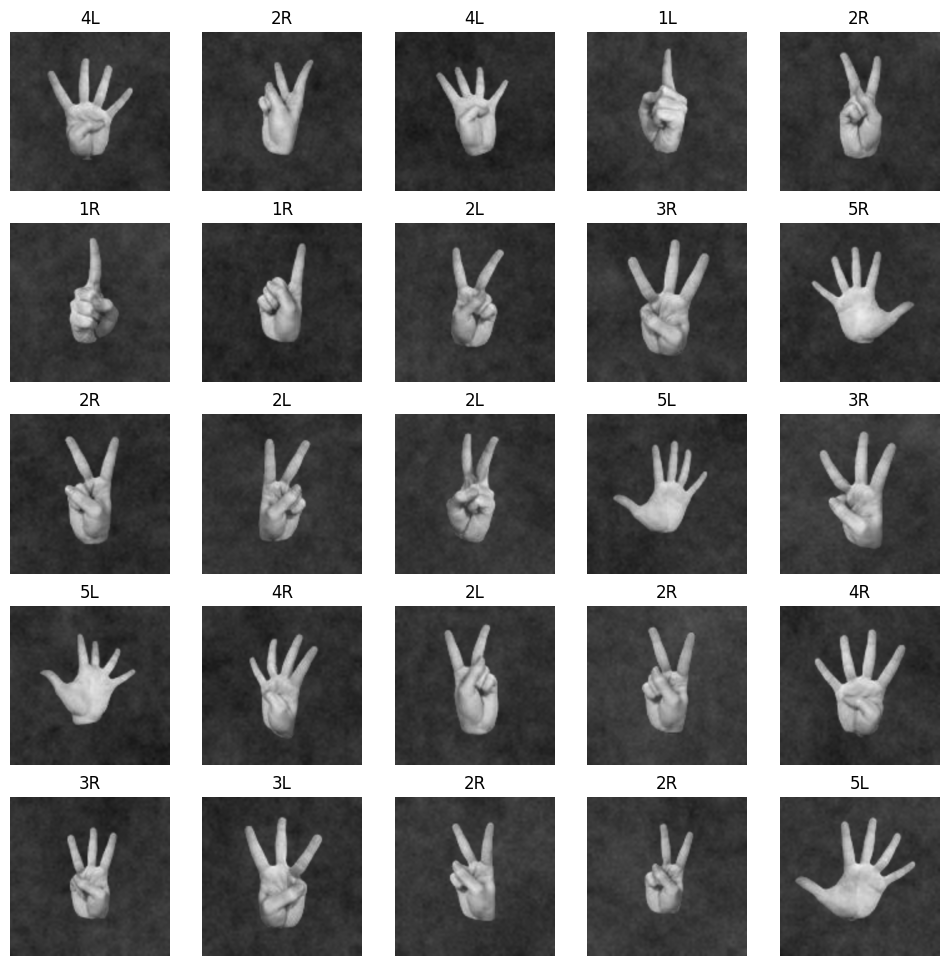

In [54]:
train_images, train_labels = next(train_data.as_numpy_iterator())
show_25_images(train_images, train_labels)

In [55]:
Input_Shape=[None,Img_size,Img_size,3] # None for Batches,Height,width,color channels
Output_Shape=len(unique_finger_train)
Model_URL="https://www.kaggle.com/models/google/mobilenet-v2/frameworks/TensorFlow2/variations/130-224-classification/versions/2"

In [56]:
def create_model(input_shape=Input_Shape,output_shape=Output_Shape,model_url=Model_URL):
  print("Building Model with:",model_url)

  # Setup Model Layers
  model = tf.keras.Sequential([
    hub.KerasLayer(model_url), # Layer 1 (input layer)
    tf.keras.layers.Dense(units=output_shape,
                          activation="softmax") # Layer 2 (output layer)
  ])

  # Compile the model
  model.compile(
      loss=tf.keras.losses.CategoricalCrossentropy(), # Our model wants to reduce this (how wrong its guesses are)
      optimizer=tf.keras.optimizers.Adam(), # A friend telling our model how to improve its guesses
      metrics=["accuracy"] # We'd like this to go up
  )

  # Build the model
  model.build(input_shape) # Let the model know what kind of inputs it'll be getting

  return model

In [57]:
model=create_model()
model.summary()

Building Model with: https://www.kaggle.com/models/google/mobilenet-v2/frameworks/TensorFlow2/variations/130-224-classification/versions/2
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer (KerasLayer)    (None, 1001)              5432713   
                                                                 
 dense (Dense)               (None, 12)                12024     
                                                                 
Total params: 5444737 (20.77 MB)
Trainable params: 12024 (46.97 KB)
Non-trainable params: 5432713 (20.72 MB)
_________________________________________________________________


In [58]:
%load_ext tensorboard

In [59]:
import datetime

def create_tensorboard_callback():
  logdir=os.path.join("drive/MyDrive/Fingers/logs",
                      datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
  return tf.keras.callbacks.TensorBoard(logdir)

In [64]:
early_stopping=tf.keras.callbacks.EarlyStopping(monitor="accuracy",
                                                patience=3)

In [65]:
Num_Epochs=100 #@param {type:"slider",min:10,max:100,step:10}

In [66]:
def train_model():
  model=create_model()
  tensorboard_callback=create_tensorboard_callback()
  model.fit(x=train_data,
            epochs=Num_Epochs,
            callbacks=[tensorboard_callback, early_stopping])
  return model

In [67]:
model = train_model()

Building Model with: https://www.kaggle.com/models/google/mobilenet-v2/frameworks/TensorFlow2/variations/130-224-classification/versions/2
Epoch 1/100
25/25 [==============================] - 6s 101ms/step - loss: 1.7673 - accuracy: 0.3550
Epoch 2/100
25/25 [==============================] - 3s 100ms/step - loss: 0.9299 - accuracy: 0.5950
Epoch 3/100
25/25 [==============================] - 3s 99ms/step - loss: 0.7695 - accuracy: 0.6538
Epoch 4/100
25/25 [==============================] - 3s 100ms/step - loss: 0.6240 - accuracy: 0.7750
Epoch 5/100
25/25 [==============================] - 3s 120ms/step - loss: 0.5505 - accuracy: 0.7862
Epoch 6/100
25/25 [==============================] - 2s 98ms/step - loss: 0.4675 - accuracy: 0.8438
Epoch 7/100
25/25 [==============================] - 2s 99ms/step - loss: 0.4452 - accuracy: 0.8487
Epoch 8/100
25/25 [==============================] - 2s 99ms/step - loss: 0.4020 - accuracy: 0.8838
Epoch 9/100
25/25 [==============================] - 3s 1

In [68]:
%tensorboard --logdir drive/MyDrive/Fingers/logs

<IPython.core.display.Javascript object>

In [69]:
test_path = "drive/MyDrive/Fingers/test/"
test_filenames = [test_path + fname for fname in os.listdir(test_path)]

test_filenames[:10]

['drive/MyDrive/Fingers/test/b7d1abc7-6882-4074-b15d-e1132cc69153_2L.png',
 'drive/MyDrive/Fingers/test/ba8b2134-a68b-4210-aaaf-94ee0159c662_3L.png',
 'drive/MyDrive/Fingers/test/bbcea6a4-3250-400f-a6d9-e5500d8f0366_5L.png',
 'drive/MyDrive/Fingers/test/b98c60c1-7519-4d5c-909f-9779b14261e0_5L.png',
 'drive/MyDrive/Fingers/test/bad120e0-aa2f-4bc4-83eb-1129be22fe83_5R.png',
 'drive/MyDrive/Fingers/test/b982e18f-945e-412b-ae80-62bc99332c4a_5R.png',
 'drive/MyDrive/Fingers/test/bc02320c-69aa-47d4-980b-3622e9eae469_2L.png',
 'drive/MyDrive/Fingers/test/b81b40b8-73aa-4b92-af1c-55446fa96cb0_5R.png',
 'drive/MyDrive/Fingers/test/baa11bf3-a7d5-4c72-877c-92548116b9bc_1R.png',
 'drive/MyDrive/Fingers/test/bb3fe31e-2530-4258-87ea-4775501f5d7f_5L.png']

In [70]:
len(test_filenames)

3600

In [71]:
test_data = create_data_batches(test_filenames, test_data=True)

Creating test data batches...


In [73]:
val_data = create_data_batches(X_val, y_val, valid_data=True)

Creating validation data batches...


In [74]:
 val_data.element_spec

(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
 TensorSpec(shape=(None, 12), dtype=tf.bool, name=None))

In [75]:
early_stopping=tf.keras.callbacks.EarlyStopping(monitor="val_accuracy",
                                                patience=3)

In [76]:
def train_model():
  model=create_model()
  tensorboard_callback=create_tensorboard_callback()
  model.fit(x=train_data,
            epochs=Num_Epochs,
            validation_data=val_data,
            validation_freq=1, # check validation metrics every epoch
            callbacks=[tensorboard_callback, early_stopping])
  return model

In [77]:
model = train_model()

Building Model with: https://www.kaggle.com/models/google/mobilenet-v2/frameworks/TensorFlow2/variations/130-224-classification/versions/2
Epoch 1/100
25/25 [==============================] - 9s 203ms/step - loss: 1.7504 - accuracy: 0.4050 - val_loss: 1.1256 - val_accuracy: 0.5150
Epoch 2/100
25/25 [==============================] - 3s 127ms/step - loss: 0.9269 - accuracy: 0.6288 - val_loss: 0.7924 - val_accuracy: 0.6650
Epoch 3/100
25/25 [==============================] - 4s 169ms/step - loss: 0.6949 - accuracy: 0.7225 - val_loss: 0.6986 - val_accuracy: 0.6900
Epoch 4/100
25/25 [==============================] - 3s 131ms/step - loss: 0.6407 - accuracy: 0.7325 - val_loss: 0.7230 - val_accuracy: 0.7000
Epoch 5/100
25/25 [==============================] - 3s 130ms/step - loss: 0.5543 - accuracy: 0.7775 - val_loss: 0.6338 - val_accuracy: 0.6950
Epoch 6/100
25/25 [==============================] - 5s 192ms/step - loss: 0.4822 - accuracy: 0.8375 - val_loss: 0.5243 - val_accuracy: 0.7900
Epo

In [78]:
%tensorboard --logdir drive/MyDrive/Fingers/logs

<IPython.core.display.Javascript object>

In [79]:
predictions=model.predict(val_data,verbose=1)
predictions

7/7 [==============================] - 40s 113ms/step


array([[9.11879761e-06, 4.34785266e-04, 9.09037590e-01, ...,
        6.23716176e-07, 3.67396567e-08, 5.96596976e-07],
       [2.90374846e-05, 1.42921981e-05, 7.43037731e-07, ...,
        3.87440179e-03, 3.57484110e-02, 2.28776294e-03],
       [2.30901525e-03, 1.83569535e-03, 1.52941642e-03, ...,
        7.03808442e-02, 7.52272957e-04, 3.33774864e-04],
       ...,
       [1.00106945e-05, 1.01689502e-05, 2.12914557e-07, ...,
        2.60452300e-01, 1.72750617e-04, 1.32737262e-03],
       [5.51191579e-06, 6.36945606e-06, 4.31342038e-08, ...,
        9.28688586e-01, 1.67540900e-04, 3.66616965e-04],
       [6.88737146e-06, 4.74738044e-05, 3.60645913e-06, ...,
        1.75966893e-03, 8.87456292e-04, 4.48862137e-03]], dtype=float32)

In [80]:
predictions.shape

(200, 12)

In [81]:
np.sum(predictions[0])

0.99999994

In [82]:
def properties(index):
  print(f"Max Probability in predictions[{index}]:{np.max(predictions[index])}")
  print(f"Sum:{np.sum(predictions[index])}")
  print(f"Max Index:{np.argmax(predictions[index])}")
  print(f"Finger:{unique_finger_train[np.argmax(predictions[index])]}")

In [83]:
properties(0)

Max Probability in predictions[0]:0.9090375900268555
Sum:0.9999999403953552
Max Index:2
Finger:1L


In [84]:
properties(5)

Max Probability in predictions[5]:0.6979864835739136
Sum:0.9999999403953552
Max Index:1
Finger:0R


In [85]:
def get_pred_label(predictions_probabilites):
  """
  Turns max probability to labels of that breed
  """
  return unique_finger_train[np.argmax(predictions_probabilites)]

In [86]:
Finger_prob=get_pred_label(predictions[81])
Finger_prob

'1L'

In [87]:
def unbatchify(data):
  """
  Takes a batched dataset of (image, label) Tensors and returns separate arrays
  of images and labels.
  """
  images = []
  labels = []

  for image, label in data.unbatch().as_numpy_iterator():
    images.append(image)
    labels.append(unique_finger_train[np.argmax(label)])
  return images, labels


In [88]:
val_images, val_labels = unbatchify(val_data)
val_images[0], val_labels[0]

(array([[[0.21176472, 0.21176472, 0.21176472],
         [0.21176472, 0.21176472, 0.21176472],
         [0.21176472, 0.21176472, 0.21176472],
         ...,
         [0.2308123 , 0.2308123 , 0.2308123 ],
         [0.22633052, 0.22633052, 0.22633052],
         [0.22352943, 0.22352943, 0.22352943]],
 
        [[0.21176472, 0.21176472, 0.21176472],
         [0.21176472, 0.21176472, 0.21176472],
         [0.21176472, 0.21176472, 0.21176472],
         ...,
         [0.23221286, 0.23221286, 0.23221286],
         [0.22773108, 0.22773108, 0.22773108],
         [0.22492999, 0.22492999, 0.22492999]],
 
        [[0.21176472, 0.21176472, 0.21176472],
         [0.21176472, 0.21176472, 0.21176472],
         [0.21176472, 0.21176472, 0.21176472],
         ...,
         [0.23445375, 0.23445375, 0.23445375],
         [0.22997198, 0.22997198, 0.22997198],
         [0.22717088, 0.22717088, 0.22717088]],
 
        ...,
 
        [[0.20000002, 0.20000002, 0.20000002],
         [0.20140058, 0.20140058, 0.20140

In [89]:
len(val_images)

200

In [90]:
len(val_labels)

200

In [91]:
unique_finger_train[np.argmax(predictions[0])]

'1L'

In [92]:
def plot_pred(prediction_probabilities, labels, images, n):
  """
  View the prediction, ground truth label and image for sample n.
  """
  pred_prob, true_label, image = prediction_probabilities[n], labels[n], images[n]

  pred_label = get_pred_label(pred_prob)

  plt.imshow(image)
  plt.xticks([])
  plt.yticks([])

  if pred_label == true_label:
    color = "green"
  else:
    color = "red"

  plt.title("{} {:2.0f}% ({})".format(pred_label,
                                      np.max(pred_prob)*100,
                                      true_label),
                                      color=color)

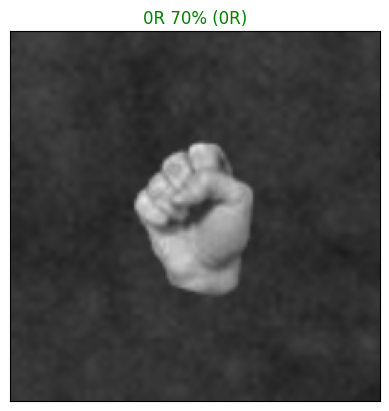

In [93]:
plot_pred(prediction_probabilities=predictions,
          labels=val_labels,
          images=val_images,
          n=5)

In [96]:
def plot_pred_conf(prediction_probabilities, labels, n=1):
  """
  Plots the top 10 highest prediction confidences along with
  the truth label for sample n.
  """
  pred_prob, true_label = prediction_probabilities[n], labels[n]

  # Get the predicted label
  pred_label = get_pred_label(pred_prob)

  # Find the top 10 prediction confidence indexes
  top_10_pred_indexes = pred_prob.argsort()[-10:][::-1]
  # Find the top 10 prediction confidence values
  top_10_pred_values = pred_prob[top_10_pred_indexes]
  # Find the top 10 prediction labels
  top_10_pred_labels = unique_finger_train[top_10_pred_indexes]

  # Setup plot
  top_plot = plt.bar(np.arange(len(top_10_pred_labels)),
                     top_10_pred_values,
                     color="grey")
  plt.xticks(np.arange(len(top_10_pred_labels)),
             labels=top_10_pred_labels,
             rotation="vertical")

  # Change color of true label
  if np.isin(true_label, top_10_pred_labels):
    top_plot[np.argmax(top_10_pred_labels == true_label)].set_color("green")
  else:
    pass

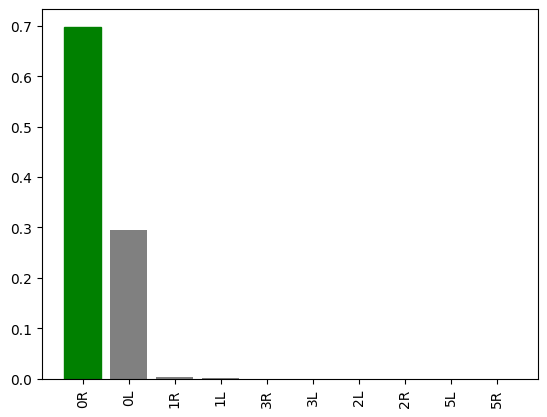

In [97]:
plot_pred_conf(prediction_probabilities=predictions,
               labels=val_labels,
               n=5)

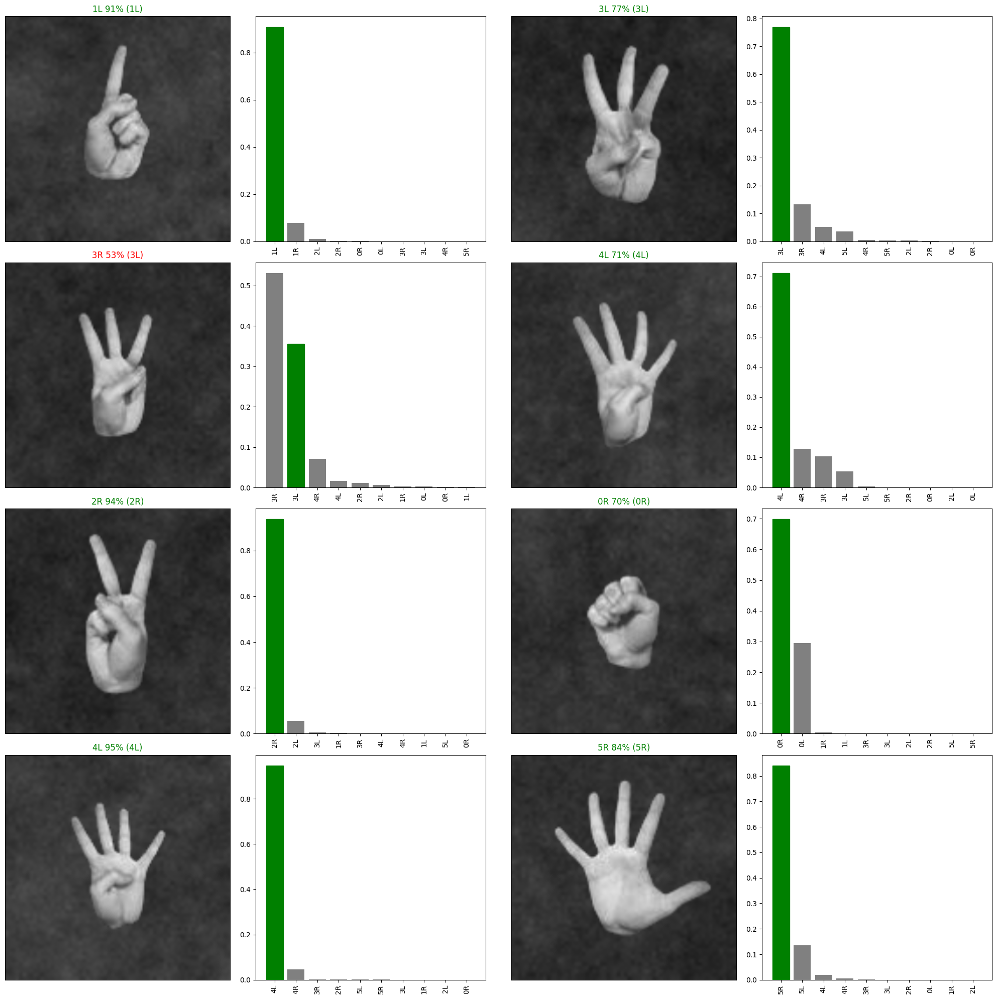

In [99]:
# Let's check a few predictions and their different values
i_multiplier = 0
num_rows = 4
num_cols = 2
num_images = num_rows*num_cols
plt.figure(figsize=(5*2*num_cols, 5*num_rows))
for i in range(num_images):
  plt.subplot(num_rows, 2*num_cols, 2*i+1)
  plot_pred(prediction_probabilities=predictions,
            labels=val_labels,
            images=val_images,
            n=i+i_multiplier)
  plt.subplot(num_rows, 2*num_cols, 2*i+2)
  plot_pred_conf(prediction_probabilities=predictions,
                labels=val_labels,
                n=i+i_multiplier)
plt.tight_layout(h_pad=1.0)
plt.show()

In [101]:
def save_model(model, suffix=None):
  """
  Saves a given model in a models directory and appends a suffix (str)
  for clarity and reuse.
  """
  # Create model directory with current time
  modeldir = os.path.join("drive/MyDrive/Fingers/models",
                          datetime.datetime.now().strftime("%Y%m%d-%H%M%s"))
  model_path = modeldir + "-" + suffix + ".h5" # save format of model
  print(f"Saving model to: {model_path}...")
  model.save(model_path)
  return model_path

In [102]:
def load_model(model_path):
  """
  Loads a saved model from a specified path.
  """
  print(f"Loading saved model from: {model_path}")
  model = tf.keras.models.load_model(model_path,
                                     custom_objects={"KerasLayer":hub.KerasLayer})
  return model

In [103]:
save_model(model, suffix="1000-images-Fingers")

Saving model to: drive/MyDrive/Fingers/models/20240217-11341708169655-1000-images-Fingers.h5...


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


'drive/MyDrive/Fingers/models/20240217-11341708169655-1000-images-Fingers.h5'

In [104]:
len(X),len(y)

(18000, 18000)

In [105]:
X[:10]

['drive/MyDrive/Fingers/train/00048bba-979b-4f84-b833-5bbbb082b582_0L.png',
 'drive/MyDrive/Fingers/train/000547a2-d456-4b16-b351-12ca9b40e390_0L.png',
 'drive/MyDrive/Fingers/train/000cac8e-fcf0-4f8c-bd16-c257d1e6d7a8_2L.png',
 'drive/MyDrive/Fingers/train/000d9961-8136-4dee-9820-86e178777958_0L.png',
 'drive/MyDrive/Fingers/train/0010095b-2e3d-4517-a511-1f688c378f96_5L.png',
 'drive/MyDrive/Fingers/train/00147c9a-67f5-4e86-a56b-681f0815ef2b_5R.png',
 'drive/MyDrive/Fingers/train/0014eacf-b0b7-49af-9d67-83661b3debb4_2R.png',
 'drive/MyDrive/Fingers/train/001cddc6-e29c-44da-82d5-bd00ec215f07_2R.png',
 'drive/MyDrive/Fingers/train/001e18d6-4632-4876-a922-7b4ead742070_3L.png',
 'drive/MyDrive/Fingers/train/00218888-86f2-4154-87f1-003dee60af03_0R.png']

In [106]:
y[:2]

[array([ True, False, False, False, False, False, False, False, False,
        False, False, False]),
 array([ True, False, False, False, False, False, False, False, False,
        False, False, False])]

In [107]:
full_data = create_data_batches(X, y)
full_model=create_model()

Creating training data batches...
Building Model with: https://www.kaggle.com/models/google/mobilenet-v2/frameworks/TensorFlow2/variations/130-224-classification/versions/2


In [108]:
full_model_tensorboard=create_tensorboard_callback()
full_model_early_stopping=tf.keras.callbacks.EarlyStopping(monitor="accuracy",
                                                           patience=3)

In [109]:
%tensorboard --logdir drive/MyDrive/Fingers/logs

Reusing TensorBoard on port 6006 (pid 18092), started 0:10:38 ago. (Use '!kill 18092' to kill it.)

<IPython.core.display.Javascript object>

In [110]:
full_model.fit(x=full_data,
               epochs=Num_Epochs,
               callbacks=[full_model_tensorboard,
                          full_model_early_stopping])

Epoch 1/100
563/563 [==============================] - 71s 119ms/step - loss: 0.5429 - accuracy: 0.7891
Epoch 2/100
563/563 [==============================] - 63s 112ms/step - loss: 0.2404 - accuracy: 0.9187
Epoch 3/100
563/563 [==============================] - 62s 110ms/step - loss: 0.1817 - accuracy: 0.9384
Epoch 4/100
563/563 [==============================] - 64s 114ms/step - loss: 0.1486 - accuracy: 0.9509
Epoch 5/100
563/563 [==============================] - 63s 111ms/step - loss: 0.1275 - accuracy: 0.9569
Epoch 6/100
563/563 [==============================] - 63s 111ms/step - loss: 0.1146 - accuracy: 0.9608
Epoch 7/100
563/563 [==============================] - 64s 114ms/step - loss: 0.1037 - accuracy: 0.9648
Epoch 8/100
563/563 [==============================] - 63s 112ms/step - loss: 0.0953 - accuracy: 0.9682
Epoch 9/100
563/563 [==============================] - 63s 112ms/step - loss: 0.0853 - accuracy: 0.9716
Epoch 10/100
563/563 [==============================] - 69s 123m

In [111]:
save_model(full_model, suffix="all-images-Fingers")

Saving model to: drive/MyDrive/Fingers/models/20240217-12141708172075-all-images-Fingers.h5...


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


'drive/MyDrive/Fingers/models/20240217-12141708172075-all-images-Fingers.h5'

In [113]:
loaded_full_model = load_model('drive/MyDrive/Fingers/models/20240217-12141708172075-all-images-Fingers.h5')

Loading saved model from: drive/MyDrive/Fingers/models/20240217-12141708172075-all-images-Fingers.h5


In [ ]:
test_predictions = loaded_full_model.predict(test_data,
                                             verbose=1)

 70/113 [=================>............] - ETA: 7:06

In [ ]:
preds_df = pd.DataFrame(columns=["id"] + list(unique_finger_train))
preds_df.head()

In [ ]:
test_path = "drive/MyDrive/Fingers/test"
preds_df["id"] = [os.path.splitext(path)[0] for path in os.listdir(test_path)]
preds_df.head()

In [ ]:
preds_df[list(unique_finger_train)] = test_predictions
preds_df.head()

In [ ]:
preds_df.to_csv("drive/My Drive/Data/full_submission_1_mobilienetV2_fingers.csv",
                 index=False)

In [3]:
from google.colab import files

files.download('drive/MyDrive/Fingers/models/20240217-12141708172075-all-images-Fingers.h5')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>